# Исследование рынка заведений общественного питания Москвы
## Описание проекта 
Требуется изучить рынок заведений общественного питания Москвы и выявить текущие тренды. Необходимо выявить существующие закономерности в расположении, категорях общественного питания - ресторан, кафе, столловая и т.д, , ценообразовании, потенциальном трафике посетителей, кол-ве посадочных мест.
Будем работать с данными о заведениях общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках.

<b>Заказчик:</b>  Инвесторы из фонда «Shut Up and Take My Money» <br>
<b>Цель:</b>  Выбор подходящего места для открытия точки общественного питания <br> 
<br>

О качестве данных ничего не известно, поэтому перед проведением анализа потребуется обзор данных. Мы проверим данные на ошибки и оценим их влияние на исследование. Затем, на этапе предобработки мы поищем возможность исправить самые критичные ошибки данных. Затем проведем исследовательский анализ и закончим все выводами, полученными в ходе исследования.<br><br>
Таким образом исследование пройдет в три этапа:<br>
1. Изучение данных
2. Предобработка данных
3. Исследовательский анализ


## Изучение данных 

###  Прочитаем файлы, произведем первичную оценку полученных данных 

In [1]:
%pip install swifter
%pip install folium
%pip install plotly==5.5

     |████████████████████████████████| 830 kB 1.4 MB/s eta 0:00:01
     |████████████████████████████████| 280 kB 59.6 MB/s eta 0:00:01
     |████████████████████████████████| 1.1 MB 81.5 MB/s eta 0:00:01
     |████████████████████████████████| 139 kB 59.8 MB/s eta 0:00:01
     |████████████████████████████████| 55 kB 1.3 MB/s  eta 0:00:01
  Created wheel for swifter: filename=swifter-1.3.4-py3-none-any.whl size=16307 sha256=bf07a820ca5eddf3daece9e0ff128631d904c1f8bcf41f249108aa3397c5ddfc
  Stored in directory: /home/jovyan/.cache/pip/wheels/2b/5e/f2/3931524f702ffd03309e96d35ee2fbf9c61c27377511ee8d4c
Successfully built swifter
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
     |████████████████████████████████| 26.5 MB 1.3 MB/s eta 0:00:01
  Attempting uninstall: plotly
    Found existing installation: plotly 5.4.0
    Uninstalling plotly-5.4.0:
      Successfully uninstalled plotly-5.4.0
Note: you m

In [2]:
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
from folium.features import CustomIcon
import json
import numpy as np
import matplotlib.pyplot as plt
from math import cos, asin, sqrt
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import swifter
import string 
import warnings

Читаем датасет в pandas

In [3]:
pd.set_option('display.max_rows', None)
warnings.filterwarnings('ignore') 

In [4]:
try:
    data = pd.read_csv('moscow_places.csv')
except:
    data = pd.read_csv('/datasets/moscow_places.csv')    

Посмотрим что из себя представляют данные:

In [5]:
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


Посмотрим на структуру данных:

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Мы видим, что часть данных в дата фрейме пропущена: hours, price, avg_bill, middle_avg_bill, middle_coffee_cup, seats.
Для удобства и экономии памяти у некторых столбцов необходимо поменять формат данных: middle_avg_bill, middle_coffee_cup, seats.

### Посмотрим на расспределение данных в датафрейме

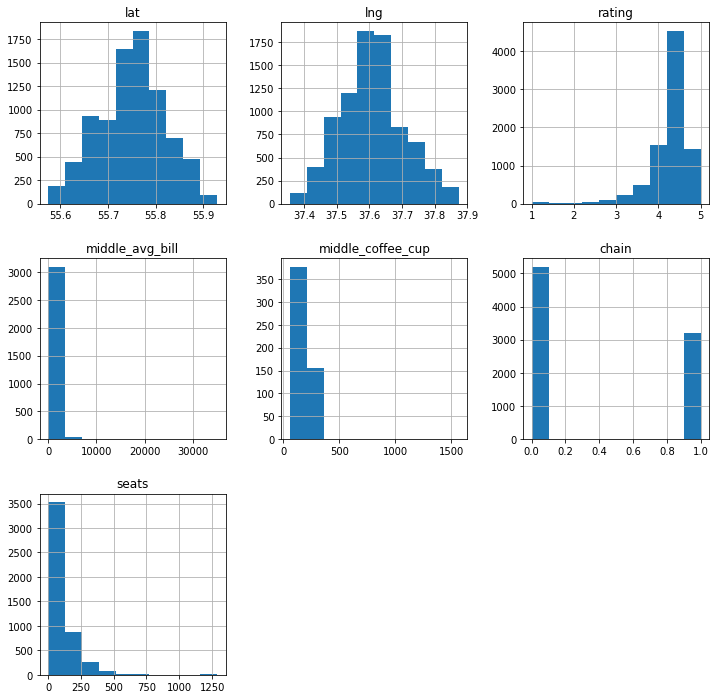

In [7]:
data.hist(figsize=(12,12));

Никаких аномалий в данных не наблюдается, lat и lng  - имеют гауссовское распределение, middle_avg_bill, middle_coffee_cup , seats - пуассоновское.
Посмотрим на стат.характеристики данных:

In [8]:
data.describe(include='all')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406,8406,8406,8406,7870,8406.000000,8406.000000,8406.000000,3315,3816,3149.000000,535.000000,8406.000000,4795.000000
unique,5614,8,5753,9,1307,NaN,NaN,NaN,4,897,NaN,NaN,NaN,NaN
top,Кафе,кафе,"Москва, проспект Вернадского, 86В",Центральный административный округ,"ежедневно, 10:00–22:00",NaN,NaN,NaN,средние,Средний счёт:1000–1500 ₽,NaN,NaN,NaN,NaN
freq,189,2378,28,2242,759,NaN,NaN,NaN,2117,241,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,55.750109,37.608570,4.229895,NaN,NaN,958.053668,174.721495,0.381275,108.421689
std,NaN,NaN,NaN,NaN,NaN,0.069658,0.098597,0.470348,NaN,NaN,1009.732845,88.951103,0.485729,122.833396
min,NaN,NaN,NaN,NaN,NaN,55.573942,37.355651,1.000000,NaN,NaN,0.000000,60.000000,0.000000,0.000000
25%,NaN,NaN,NaN,NaN,NaN,55.705155,37.538583,4.100000,NaN,NaN,375.000000,124.500000,0.000000,40.000000
50%,NaN,NaN,NaN,NaN,NaN,55.753425,37.605246,4.300000,NaN,NaN,750.000000,169.000000,0.000000,75.000000
75%,NaN,NaN,NaN,NaN,NaN,55.795041,37.664792,4.400000,NaN,NaN,1250.000000,225.000000,1.000000,140.000000


Оценку данных сильно затрудняют прорущенные значения - NaN. Этим мы займемся после проверки дата фрейма на дубликаты

###  Посмотрим на наличие дубликатов в датафрейме

In [9]:
data.duplicated().sum()

0

Отлично! дубликаты в дата фрейме отсутствуют. Переходим к пропущенным данным

##  Предобработка данных 

###  Подготовка данных для анализа

копейками никто не пользуется, поэтому конвертируем 'middle_avg_bill', 'middle_coffee_cup' в int

####  Конвертация столбца 'chain'

в столбце существуют только значения 0 и 1 , поэтому для сокращения потребления памяти конвертируем в int32

In [10]:
data['chain'].unique()

array([0, 1])

In [11]:
data['chain'] = data['chain'].astype(int)

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


###  Проверка на наличие дубликатов в столбцах

#### Столбец 'name'

Ранее мы уже проверили датасет на наличие дубликатов, но это были явные дубликаты, т.е. строки полностью похожие друг на друга. А как быть с неявными дубликатами - опечатки, разное написание одного и того же названия, замена одного символа в названии другим и прочее? Попробуем их найти в столбце 'name'. 
Нужен алгоритм, т.к руками проверить 8400 названий занятие неральное:
1. сравнить все названия, предварительно преоразовав их в нижний регистр, убрав из названий все возможные знаки пунктуаций и пробелы, оставим только буквы в нижнем регистре. Так больше шансов, что разные написания одного и того же названия станут одним набором букв. Составить список совпадений - оригинальные, не преобразованные названия.
2. Используя данные по координатам каждой точки общественного питания найти все соседние точки в заданном радиусе от данной точки. Составить список соседних точек.
3. Проврить есть ли названия из первого списка во втором. Если такие есть, то это и есть дубликаты. Параллельно проверить совпадение адреса этих точек визуально - список уже не должен быть слишком большим.
Поехали!

Напишем функцию для поиска сопадений названий, через преобразование названий в набор символов:

In [13]:
def replace_all(val):
    ps = string.punctuation + string.whitespace + "’" + "'"
    for r in ps:
        val = val.replace(r, '')
    val = val.replace('and','')    
    return val
data['name_found1'] = data['name'].swifter.apply(replace_all).str.lower()

Pandas Apply:   0%|          | 0/8406 [00:00<?, ?it/s]

Найдем дубликаты по новому столбцу 'name_found1' и 'address':

In [14]:
data[data.duplicated(['name_found1', 'address'],keep='last')]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_found1
599,В парке вкуснее!,кафе,"Москва, Северный административный округ, район...",Северный административный округ,"ежедневно, 10:00–21:00",55.854571,37.487254,2.2,NaN,NaN,NaN,NaN,0,NaN,впаркевкуснее
1430,More poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0,morepoke
2211,Раковарня Клешни и Хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0,раковарняклешниихвосты
3091,Хлеб да Выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0,хлебдавыпечка
4613,Cafe 13,кафе,"Москва, Мясницкая улица, 13, стр. 11",Центральный административный округ,пн-чт 10:00–22:00; пт 10:00–19:00,55.762779,37.633079,4.3,NaN,NaN,NaN,NaN,0,200.0,cafe13
5764,VIP Wok & sushi,быстрое питание,"Москва, Можайское шоссе, 45Б",Западный административный округ,"ежедневно, 11:00–23:00",55.716484,37.407236,4.2,NaN,NaN,NaN,NaN,0,16.0,vipwoksushi


Удалим дубликаты по номерам строчек:

In [15]:
data.drop([4613, 1430, 5764, 599, 2211, 3091], inplace=True)

In [16]:
data.drop(columns=['name_found1'], inplace=True)

Таким, образом мы избавились от дубликатов данных в датасете. Идем дальше...

#### Столбец 'category'

Проверим, как обстоят дела со столбцом:

In [17]:
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

Дубликатов в столбце 'category' нет

####   Столбец 'district'

Проверим, как обстоят дела со столбцом:

In [18]:
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

Дубликатов в столбце 'district' нет

#### Столбец 'hours'

Проверим длину списка уникальных значений столбца 'hours': 

In [19]:
len(data['hours'].unique())

1307

####   Столбец 'price'

In [20]:
data['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

Дубликатов нет, всего 4 категории

### Создание дополнительных вспомогательных столбцов

Сократим вывод датасетов до 30 строк - для более комфортой работы

In [21]:
pd.set_option('display.max_rows', 30)

#### Столбец 'street'

Будем создавать его из столбца 'address'

Напишим функцию получения улицы из полного адреса:

In [22]:
def get_street(val):
    streets = ('улица','проезд', 'проспект', 'шоссе', 'площадь','бульвар', 
           'МКАД', 'парк', 'заказник', 'переулок', 'аллея', 'набережная', 'тупик', 
           'квартал', 'микрорайон', 'сквер', 'жилой комплек', 'просек')
    districts = ['округ', 'поселок', 'район', 'город', 'деревня' ]
    val_lst = val.split(',')
    for ilocation in val_lst[1:]:
        for loc in streets:
            if loc in ilocation:
                if loc != 'МКАД':
                    return ilocation
                else: 
                    return loc + ', ' + val_lst[2]

            else:
                continue
    return ''

Применим ее к датасету

In [23]:
data['streets'] = data['address'].apply(get_street)

In [24]:
pd.set_option('display.max_colwidth', 50) # default 50 , None  -no limit
pd.set_option('display.max_rows', 30)

#### Столбец 'is_24/7'

In [25]:
data['is_24/7'] = data['hours'].apply(lambda x: True if x == 'ежедневно, круглосуточно' else False)

По итогам предобработки данных мы: 
1. избавились от неявных дубликатов в столбце 'name' - удалили соответствующие дубликатам строки 
2. сковертировали столбец 'chain' в  int 
3. добавили необходимыее в дальнешем анализе столбцы - 'streets' и 'is_24/7'.
Теперь данные готовы к анализу.

## Анализ данных 

### Кол-во заведений общественного питания Москвы по категориям 

In [26]:
pt_cats = pd.pivot_table(data, index='category', values='name', 
                         aggfunc='count').sort_values(by=['name'], 
                         ascending=False).reset_index().rename(columns={'name':'кол-во'})

In [27]:
fig = px.bar(pt_cats, x='кол-во', y='category',title='Кол-во заведений по категориям')
fig.update_traces(textposition='inside', text=pt_cats['кол-во'])
fig.update_xaxes(title_text='Кол-во') # ось x
fig.update_yaxes(title_text='Категория', secondary_y=False) # ось y - primary

fig.show()

Как видно на графике больше всего в Москве заведенией в категории "кафе", далее следует категория "ресторан", на 3 месте находится категория "кофейня"

### Кол-во посадочных мест заведений общественного питания Москвы по категориям 

In [28]:
pt = pd.pivot_table(data, index='category', values='seats', aggfunc=['sum','median']
                   ).reset_index()
pt.columns = ['category', 'total_seats', 'avg_seats']
pt['avg_seats'] = round(pt['avg_seats'])
pt = pt.sort_values(by=['total_seats'], ascending=False)

In [29]:
fig = make_subplots(specs=[[{"secondary_y": True}]])  # создаем плотно на 2 оси y
# Создаем на полотне графики 
fig.add_trace(go.Bar(x=pt['category'], y = pt['total_seats'], text=pt['total_seats'],
                     name='Общее кол-во мест'), secondary_y=False)
fig.add_trace(go.Scatter(
    x=pt['category'], 
    y = pt['avg_seats'], 
    text=pt['avg_seats'],      # значения меток
    textposition='top right', # расположение меток в верху в центре
    mode='lines+markers+text', # режим обображения линий, маркеров и меток
    name='Медианное кол-во мест'), # название кривой
    secondary_y=True             # указание на использование y-secondary
    ) 
# Заголовок
fig.update_layout(title_text='Кол-во посадочных мест и среднее кол-во место в заведениях по категориям') 
fig.update_xaxes(title_text='Категории') # ось x
fig.update_yaxes(title_text='Общее кол-во мест', secondary_y=False) # ось y - primary
fig.update_yaxes(title_text='Медианное кол-во мест', secondary_y=True) # ось y - secondary
fig.show()

Мы видим, что в случае общего кол-ва мест категории распределяются также как и в случае кол-ва заведений по категориям, т.е больше всего посадочных мест в категории 'ресторан', что вообщем-то не удивительно и меньше всего в 'булочная', что тоже не удивляет. А вот в случае со медианным кол-вом мест ситуация другая. Больше всего мест также в 'ресторан', что опять не удивительно, но такое же парктичеки такое же кол-во мест у категории 'бар, паб' и 'кофейня'.Удивляет медианное кол-во мест у категорий 'кафе' и 'пиццерия' - 60 и 55 мест соответственно. Это практически одни из самых маленьких значений. Посмотрим на распределение посадочных мест в категориях: 

In [30]:
fig = px.box(data, x='category', y='seats', 
             labels={'category':'категория', 'seats':'кол-во мест'})
fig.update_yaxes(range = [0,160])
fig.show()

На графике мы видим, что в категории 'кафе' максимальное кол-во заведений сконцентрировано в районе 60 посадочных мест, что и приводит к такому виду графика, котрый мы наблюдаем выше. тоже и с пиццерией большая часть заведений сконцентрирована в районе 55 мест.Ничего необычно в распределении нет.

### 3.3 Сетевые и несетевые заведения в Москве  

Посмотрим на разделение заведений общественного питания Москвы на сетевые и несетевые: 

In [31]:
s = data['chain'].value_counts()

In [32]:
fig = px.pie(s, values=s.values,  
                names={
                       'is_not_chain': 'не сетевые',
                       'is_chain': 'сетевые'
                     },
title='Кол-во заведений по категориям')
fig.update_traces(textposition='inside', textinfo='percent+label', hole=.3)
fig.update_layout(
    autosize=False,
    height=400,
    width=1000,
    annotations=[dict(text='Москва', x=0.5, y=0.5, font_size=20, showarrow=False)],
    margin = dict(t=30, l=0, r=0, b=0)
)    
fig.show()

Мы видим, что кол-во несетевых заведений в Москве в 1,6 раза больше чем сетевых. Посмотрим на разделение по категориям:

In [33]:
data['chain_ask'] = data['chain'].apply(lambda x: 'сетевые' if x == 1 else 'несетевые')

In [34]:
pv_cat_chain = pd.pivot_table(data, index=['category','chain_ask'], values='name',
                              aggfunc='count').reset_index().rename(columns={'name':'qty'}
                                                                   ).sort_values(
                                                                    by='qty', ascending=False)
pv_cat_chain

,category,chain_ask,qty
6,кафе,несетевые,1597
12,ресторан,несетевые,1311
7,кафе,сетевые,779
13,ресторан,сетевые,730
9,кофейня,сетевые,720
8,кофейня,несетевые,693
0,"бар,паб",несетевые,596
4,быстрое питание,несетевые,370
11,пиццерия,сетевые,330
10,пиццерия,несетевые,303


In [35]:
/
fig = px.bar(pv_cat_chain, x='category', y='qty', color='chain_ask', 
labels={'qty':'процент', 'category': 'категория', 'chain_ask':''}, 
height=500,
text_auto=True,
title='Распределение сетевых и несетевых заведений по категориям')
fig.update_layout(
    autosize=False,
    height=600,
    width=900,
    barnorm='percent',
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

По графику видно, что больше всего в процентном отношении сетевых заведений находится среди категорий 'кофейня', 'пиццерия' и 'булочная'. Доли сетевых заведений в этих категориях составляет более 50%. Во всех остальных категориях кол-во несетевых заведений преобладает над кол-вом сетевыми. 

### Top 15 сетей Москвы:

Названия районов Москвы очень длинные, поэтому для удобства сократим их до абривиатуры

In [36]:
def cut_district_name(val):
    if val == 'Северный административный округ':
        return 'САО'
    if val == 'Северо-Восточный административный округ':
        return 'СВАО'
    if val == 'Северо-Западный административный округ':
        return 'СЗАО'
    if val == 'Западный административный округ':
        return 'ЗАО'
    if val == 'Центральный административный округ':
        return 'ЦАО'
    if val == 'Восточный административный округ':
        return 'ВАО'
    if val == 'Юго-Восточный административный округ':
        return 'ЮВАО'
    if val == 'Южный административный округ':
        return 'ЮАО'
    if val == 'Юго-Западный административный округ':
        return 'ЮЗАО'                                  

In [37]:
data['district1'] = data['district'].apply(cut_district_name)

Найдем топ 15 сейтей Москвы:

In [38]:
top_15 = data.loc[data['chain'] == 1,['name', 'category', 'chain']].groupby(['name']
)['chain'].agg('count').reset_index().sort_values(by='chain', ascending=False).head(15)
top_15.columns = ['name','qty']

Добавим категорию к названию сети:

In [39]:
def find_category(val):
    return data.apply(lambda row: row['category'] if row['name'] == val else '',
                                                              axis=1).unique()[1]

In [40]:
top_15['category'] = top_15['name'].apply(find_category)

Проиллюстрируем данные выше при помощи графика:

In [41]:
fig = px.bar(top_15, x='name', y='qty', 
labels={'qty':'кол-во', 'name': 'название сети'}, 
height=500,
text = 'qty',
title='top15 сетей города')
fig.update_layout(
    autosize=False,
    height=600,
    width=900,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

Посмотрим на распределение этих 15 крупнейших сетей по Москве:

Отфильтруем данные по сетям и названиям топ 15 сетей:

In [42]:
data1 = data.loc[(data['chain'] == 1) & (data['name'].isin(top_15['name'].to_list()))]

Сгруппируем данные по районам и названиям сетей и посчитаем кол-во каждой сети в каждом районе:

In [43]:
data2 = pd.pivot_table(data1, index=['name','district1'], values='chain',
                                                       aggfunc='sum').reset_index()
data2.columns = ['name', 'district', 'qty']
data2['percent'] = data2['qty'] / data2.groupby(['name'])['qty']. transform('sum')
data2['percent'] = data2['percent'].round(3) * 100 
data2.sort_values(by='percent', ascending=False)

,name,district,qty,percent
72,Кулинарная лавка братьев Караваевых,ЦАО,32,82.1
32,Prime,ЦАО,37,74.0
78,Му-Му,ЦАО,15,55.6
65,КОФЕПОРТ,ЦАО,15,35.7
95,Хинкальная,ЦАО,14,31.8
...,...,...,...,...
92,Хинкальная,САО,1,2.3
31,Prime,СЗАО,1,2.0
30,Prime,СВАО,1,2.0
27,Prime,ВАО,1,2.0


Посторим график на базе полученных выше данных:

In [44]:
fig = px.bar(data2, x='name', y='percent', color='district', 
labels={'percent':'проценты', 'name': 'название сети','district':'район'}, 
height=500,
#text='qty',
text_auto=True,             
title='Распределение top15 сетей по районам города')
fig.update_layout(
    autosize=False,
    height=600,
    width=900,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

Из графика видно, что все сети представлены в Центральном административном округе Москвы. Причем у одних сетей этот округ является приоритетным:
- Шоколоадница
- One Price Coffee
- Cofix
- Prime
- КОФЕПОРТ
- Кулинарная лавка братьев Караваевых
- Кофемания <br>

Оставшиеся сети распределены в большей степени по другим округам.

### Распределение заведений общественного питания по районам Москвы:

In [45]:
dists = pd.pivot_table(data, index='district1', values= 'name', aggfunc='count'
                                                                  ).reset_index()
dists.columns = ['district', 'qty']
dists.sort_values(by='qty', ascending=False)

,district,qty
5,ЦАО,2241
2,САО,898
6,ЮАО,892
3,СВАО,890
1,ЗАО,849
0,ВАО,798
7,ЮВАО,714
8,ЮЗАО,709
4,СЗАО,409


In [46]:
fig = px.pie(dists, values='qty', names='district', title='Распределение заведений общественного питания по районам Москвы')
fig.update_traces(textposition='inside', textinfo='percent+label', hole=0.3)
# меняем размер графика
fig.update_layout(
    autosize=False,
    height=600,
    width=900,
    annotations=[dict(text='Москва', x=0.5, y=0.5, font_size=20, showarrow=False)],
    margin = dict(t=30, l=0, r=0, b=0)
)    
fig.show()

Больше всего заведений находится в ЦАО - как минимум все сетевые предприятия в нем представлены, за ЦАО следуют 3 рйона с примерно одинаковым кол-вом заведений: САО, ЮАО, СВАО, ЗАО. За ними еще 3 района тоже с похожим кол-вом заведений: ВАО, ЮВАО, ЮЗАО и замыкает районы СЗАО с намменьшим кол-вом заведений.<br>
Посмотрим, как представлены категории заведений в районах города:

In [47]:
pv = pd.pivot_table(data, index=['district1', 'category'], values='name', 
                                            aggfunc='count').reset_index()
pv.columns= ['district','category', 'qty']
pv = pv.sort_values(by='qty', ascending=False)

In [48]:
fig = px.bar(pv, x='district', y='qty', color='category', 
labels={'district':'район', 'qty':'проценты', 'category': 'категория'}, 
height=500,
text_auto=True,
title='Распределение категорий заведений по районам города')
fig.update_layout(
    autosize=False,
    height=600,
    width=900,
    barnorm='percent',
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

Во всех районах города три категории: кафе, ресторан , кофейня удерживают долю в районе 70%, как и по Москве в целом

Создадим таблицу с рейтингами каждой категории в каждом районе Москвы и добавим рейтинг в целом по Москве:

In [49]:
# создадим таблицу категории в строчках и районы в столбцах(можно было сделать через pivot, но в итоге выдает ошибку, разбираться нет времени)
inds = pv['category'].unique()
cols = pv['district'].unique()
pv_tab = pd.DataFrame(index=inds, columns=cols, data=[[0*len(inds)]*len(cols)])
for i in pv_tab.index:
    for j in pv_tab.columns:
        pv_tab.loc[i,j] = pv.loc[(pv['category']==i) & (pv['district']==j),
                                                             'qty'].to_numpy()[0]
#переименуем столбцы
pv_tab = pv_tab.reset_index()
pv_tab.columns = ['category','ВАО','ЗАО','САО','СВАО','СЗАО','ЦАО','ЮАО','ЮВАО','ЮЗАО']
# добавим информацию из таблицы с данными по Москве
pv_tab = pv_tab.merge(pt_cats, left_on=pv_tab['category'], right_on=pt_cats['category'] 
                        ).drop(['category_x','category_y'], axis=1)
pv_tab.columns = ['category',	'ВАО',	'ЗАО',	'САО',	'СВАО',	'СЗАО',	'ЦАО',	'ЮАО',
                  'ЮВАО',	'ЮЗАО',	'Москва']
pv_tab = pv_tab.sort_values(by='Москва', ascending=False)
# получим рейтинги каждой категории в каждом раоне Москвы
for i in pv_tab.columns[1:]:
    str = i + ' rank'
    pv_tab[str] = 9 - pv_tab[i].rank()  # инвертируем значения рейтинга в более понятные
    pv_tab.drop(columns=i, inplace=True)


In [50]:
pv_tab

,category,ВАО rank,ЗАО rank,САО rank,СВАО rank,СЗАО rank,ЦАО rank,ЮАО rank,ЮВАО rank,ЮЗАО rank,Москва rank
1,кафе,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
0,ресторан,1.0,2.0,2.0,2.0,2.0,2.0,2.0,3.0,2.0,2.0
2,кофейня,3.0,3.0,3.0,3.0,3.0,3.0,3.0,2.0,3.0,3.0
3,"бар,паб",4.0,6.0,6.0,6.0,6.0,6.0,6.0,5.0,6.0,4.0
4,пиццерия,5.0,5.0,4.0,5.0,5.0,4.0,4.0,4.0,4.0,5.0
5,быстрое питание,6.0,4.0,5.0,4.0,4.0,5.0,5.0,6.0,5.0,6.0
6,столовая,7.0,7.0,7.0,7.0,7.0,8.0,8.0,7.0,7.0,7.0
7,булочная,8.0,8.0,8.0,8.0,8.0,7.0,7.0,8.0,8.0,8.0


Что мы видим? "кафе" во всех районах, кроме центрального занимает первое место по кол-ву точек. В ЦАО на пермом месте - "ресторан". Это вполне ожидаемо - центр всегда ассоциировался с чем-то праздничным, торжественным, как и "ресторан". 
"Ресторан" - во всех районах кроме центрального, который мы только что обсудили, и северо-восточного на втором месте. В северо-восточном на втором месте находятся "кофейни".
"Кофейня" - везде стоит на 3 месте по кол-ву торговых точек (кроме СВАО). А вот дальше идут 3 категории, которые в сравнении с местом по Москве в целом, по районам ведут себя по разному - меняясь друг с другом местами. Так "бар,паб" имея в целом по Москве 4 позицию, в районах почти везде спустился на 2 места ниже и занял 6 позицию, кроме САО.
"пицерия" в 5 случаях из 9 осталась на своем месте, а в оставшихся 4 районах проиграла конкуренцию категории "быстрое питание".
Осташиеся две категории "столовая" и "булочная" остались на своих местах замыкая список категорий, имсключение составили 2 района, где эти категории поменялись между собой местами. 

###  Распределение средних рейтингов точек общественного питания по категориям:

In [51]:
pt_rat = pd.pivot_table(data=data, index='category', values='rating', 
                        aggfunc='mean').reset_index()
pt_rat['rating'] = pt_rat['rating'].round(2)
pt_rat = pt_rat.sort_values(by='rating', ascending=False)

Визуализируем полученные данные:

In [52]:
# Создаем на полотне графики 
fig = px.bar(pt_rat, x='category', y='rating', text='rating',labels={'rating':'рейтинг',
                                                                'category': 'категория'})
# Заголовок
fig.update_layout(title_text='Средний рейтинг по категориям') 
fig.show()

Мы видим, что средние срейтинги по категориям практически не отличаются друг от друга - все значения выше 4, более тоге они все находятс в пределах 4.3, за исключением категории "быстрое питание" у которй всего 4.05 и "кафе" - 4.12

### Распределение средних рейтингов точек общественного питания по районам Москвы:

Подготовим данные по средним рейтингам точек общепита по районам для визуализации: 

In [53]:
pt = pd.pivot_table(data, index='district', values='rating', 
                    aggfunc='mean').reset_index().sort_values(by='rating', ascending=False)
pt['rating'] = pt['rating'].round(2)
pt

,district,rating
5,Центральный административный округ,4.38
2,Северный административный округ,4.24
4,Северо-Западный административный округ,4.21
8,Южный административный округ,4.18
1,Западный административный округ,4.18
0,Восточный административный округ,4.17
7,Юго-Западный административный округ,4.17
3,Северо-Восточный административный округ,4.15
6,Юго-Восточный административный округ,4.10


In [54]:
# читаем файл и сохраняем в переменной
try:
    with open('/datasets/admin_level_geomap.geojson', 'r', encoding='utf-8') as f:  
        geo_json = json.load(f)
except:
    with open('admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
        geo_json = json.load(f)


In [55]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
my_map = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=pt,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.7,
    legend_name='Средний рейтинг заведений по районам',
).add_to(my_map)

# выводим карту
my_map

Отобразим все точки общественного питания указанные в датасете на карте Москвы с помощью кластеров:

In [56]:
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(my_map)
# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/external-wanicon-flat-wanicon/344/external-mall-shop-and-store-wanicon-flat-wanicon.png' 
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.swifter.apply(create_clusters, axis=1)

# выводим карту
my_map

Pandas Apply:   0%|          | 0/8400 [00:00<?, ?it/s]

На карте видно, что самое большое кол-во заведений находится в центре Москвы и уменьшается к ее окраинам. Средний рейтинг также имеет максиммальное значение в центре города - конкуренция оказывает влияние. В других районах города рейтинг ниже, как и кол-во точек общественного питания. Чем меньше конкуренция, тем ниже качество обслуживания.

### Топ 15 улиц по кол-ву заведений Москвы:

In [57]:
data1 = data[data['streets'] != '']

In [58]:
top15_streets = pd.pivot_table(data1, index='streets', values='name', 
                               aggfunc='count').reset_index().sort_values(by='name', 
                                                            ascending=False).head(15)

In [59]:
top15_streets_cats = pd.pivot_table(data1, index=['streets','category'], values='name',
                                    aggfunc='count').reset_index()

In [60]:
top15_streets_cats = top15_streets_cats[top15_streets_cats['streets'].isin(
    top15_streets['streets'].unique())].sort_values(by='streets', ascending=False)

In [61]:
top15_streets_cats.columns = ['streets', 'category', 'qty']
top15_streets_cats = top15_streets_cats.sort_values(by='qty', ascending=False)

In [62]:
fig = px.bar(top15_streets_cats, x='streets', y='qty', color='category', 
labels={'streets':'улицы', 'qty':'проценты', 'category': 'категория'}, 
height=500,
text_auto=True,
title='Распределение категорий заведений по top15 улиц по кол-ву заведений')
fig.update_layout(
    autosize=False,
    height=600,
    width=900,
    barnorm='percent',
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
)
fig.show()

Интересно, как распределяются топ15 улиц по районам города:

In [63]:
data1[data1['streets'].isin(top15_streets['streets'].unique())].groupby(['streets',
                                                        'district1'])['name'].count()

streets                  district1
 Алтуфьевское шоссе      СВАО          47
 Варшавское шоссе        ЮАО           76
 Дмитровское шоссе       САО           65
                         СВАО          23
 Каширское шоссе         ЮАО           77
 Кутузовский проспект    ЗАО           54
 Ленинградский проспект  САО           95
 Ленинградское шоссе     САО           70
 Ленинский проспект      ЗАО           21
                         ЦАО            8
                         ЮАО           12
                         ЮЗАО          66
 Люблинская улица        ЮВАО          60
 Профсоюзная улица       ЮЗАО         122
 Пятницкая улица         ЦАО           48
 проспект Вернадского    ЗАО           95
                         ЮЗАО          13
 проспект Мира           СВАО         131
                         ЦАО           52
 улица Вавилова          ЮАО           19
                         ЮЗАО          36
 улица Миклухо-Маклая    ЮЗАО          49
Name: name, dtype: int64

топ15 улиц проходят только через 7 районов города

### Улицы с одним заведением общественного питания:

In [64]:
down_streets = pd.pivot_table(data1, index='streets', values='name', 
                              aggfunc='count').reset_index().sort_values(by='name')
down_streets = down_streets[down_streets['name'] < 2]
down_streets.columns = ['streets','qty']
down_streets.shape

(467, 2)

Получили список из 467 улиц

Получим по этим улицам всю информацию по заведениям, которые там расположены:

In [65]:
data3 = data[data['streets'].isin(down_streets['streets'].unique())]

Определим какие категории представлены и в каком кол-ве:

In [66]:
pd.pivot_table(data3, index='category', values='name', 
               aggfunc='count').reset_index().sort_values(by='name', ascending=False)

,category,name
3,кафе,161
6,ресторан,91
4,кофейня,89
0,"бар,паб",41
7,столовая,37
2,быстрое питание,23
5,пиццерия,15
1,булочная,10


Оценим средний чек по Москве по каждой категории:

In [67]:
pd.pivot_table(data, index='category', values='middle_avg_bill', 
               aggfunc='mean').reset_index().sort_values(by='middle_avg_bill', 
                                                         ascending=False).round()

,category,middle_avg_bill
6,ресторан,1368.0
0,"бар,паб",1339.0
5,пиццерия,789.0
3,кафе,708.0
1,булочная,659.0
4,кофейня,614.0
2,быстрое питание,446.0
7,столовая,335.0


Оценим средний чек на улицах с одним заведением по каждой категории:

In [68]:
pd.pivot_table(data3, index='category', values='middle_avg_bill', 
               aggfunc='mean').reset_index().sort_values(by='middle_avg_bill',
                                                         ascending=False).round()

,category,middle_avg_bill
5,ресторан,1664.0
0,"бар,паб",1400.0
4,пиццерия,786.0
1,быстрое питание,736.0
2,кафе,658.0
3,кофейня,568.0
6,столовая,283.0


По средним значениям среднего чека улицы с 1 заведением чуть дороже чем в целом по Москве, что подтверждает мысль - отсутствие конкуренции порождаяет рост цен.

Посмотрим на средние значения посадочных мест по категориям в Москве в целом:

In [69]:
pd.pivot_table(data, index='category', values='seats', 
               aggfunc='mean').reset_index().sort_values(by='seats', 
                                                         ascending=False).round(2)

,category,seats
0,"бар,паб",124.53
6,ресторан,121.87
4,кофейня,111.20
7,столовая,99.75
2,быстрое питание,99.13
3,кафе,97.43
5,пиццерия,94.50
1,булочная,88.12


Средние значения посадочных мест по категориям на улицах с 1 заведением:

In [70]:
pd.pivot_table(data3, index='category', values='seats', 
               aggfunc='mean').reset_index().sort_values(by='seats', 
                                                         ascending=False).round(2)

,category,seats
7,столовая,83.29
6,ресторан,72.44
0,"бар,паб",66.00
5,пиццерия,59.89
1,булочная,59.60
2,быстрое питание,47.43
4,кофейня,47.17
3,кафе,44.98


Мы видим, что на улицах с 1 заведением в среднем кол-во посадочных мест ниже чем в среднем по Москве, учитывая, что улицы не самые популярные и расположены вне основоного потока потенциальных посетителей - расчитаны скорее на 'местных' посетителей, это выглядит логично. 

In [71]:
data_hours = pd.pivot_table(data3, index=['category','hours'], values='name', 
                            aggfunc='count').reset_index().sort_values(by=['name'], 
                                                                       ascending=[False])

Посмотрим на наиболее частый график работы по категориям в целом по Москве:

In [72]:
for cat in data_hours['category'].unique():
    print(cat, data[data['category'] == cat].mode()['hours'][0])

кафе ежедневно, круглосуточно
ресторан ежедневно, 10:00–22:00
кофейня ежедневно, 10:00–22:00
быстрое питание ежедневно, круглосуточно
столовая пн-пт 09:00–17:00
бар,паб ежедневно, 12:00–00:00
пиццерия ежедневно, 10:00–22:00
булочная ежедневно, 08:00–22:00


Посмотрим на наиболее частый график работы по категориям на улицах с одним заведением:

In [73]:
for cat in data_hours['category'].unique():
    print(cat, data_hours[data_hours['category'] == cat].mode()['hours'][0])

кафе вт-вс 10:00–20:00
ресторан вт-сб 12:00–21:00
кофейня вт-вс 10:00–20:00
быстрое питание вт-вс 09:00–19:00
столовая ежедневно, 09:00–20:00
бар,паб вт-вс 12:00–00:00
пиццерия ежедневно, 09:00–23:00
булочная вт-вс 12:00–20:00


Мы видим, что в Москве в целом, наиболее часто заведения работают ежедневно с 10 до 22 часов, кроме "столовая", которая работает с 9 до 17 по рабочим дням. это говорит, что в данном случае основными посетителями являются работники предприятий.
В случае с улицами с одним заведением работают с выходным в понедельник(исключение столовая и пиццерия) до 20-00 (иключение пиццерия и ресторан). Вообще пицерия выглядит как не от сюда - у нее самый длиный рабочий день и работает ежедневно. Посмотрим на эту категорию поближе:

In [74]:
data3[data3['category'] == 'пиццерия']['chain_ask'].value_counts()

сетевые      9
несетевые    6
Name: chain_ask, dtype: int64

Что и требовалось доказать - 2/3 всех заведений пиццерии это сетевые заведения. Это значит, что они работают по определнным правилам, не важно где они находятся.

Посмотрим, что с точки зрения сетевых заведений у других категорий:

In [75]:
for cat in data_hours['category'].unique():
    print(cat, data3[data3['category'] == cat]['chain_ask'].value_counts())

кафе несетевые    116
сетевые       45
Name: chain_ask, dtype: int64
ресторан несетевые    69
сетевые      22
Name: chain_ask, dtype: int64
кофейня несетевые    53
сетевые      36
Name: chain_ask, dtype: int64
быстрое питание несетевые    16
сетевые       7
Name: chain_ask, dtype: int64
столовая несетевые    28
сетевые       9
Name: chain_ask, dtype: int64
бар,паб несетевые    35
сетевые       6
Name: chain_ask, dtype: int64
пиццерия сетевые      9
несетевые    6
Name: chain_ask, dtype: int64
булочная несетевые    6
сетевые      4
Name: chain_ask, dtype: int64


Все подтвердилось - из всех категорий на улицах с одним заведением только у пиццерия кол-во сетевых заведений больше. Все остальные категории - это в основном несетевые заведения, которые устанавливают сви правила функционирования.<br>
Таким образом, на улицах с одним заведением:
- средний чек в заведениях чуть выше чем в среднем по Моске
- кол-во посадочных мест тоже меньше чем в среднем по Москве
- период работы заведений более короткий в сравнении с Москвой в целом
- кол-во несетевых заведений значительно больше чем сетевых

### Средний чек в заведении по районам Москвы:

In [76]:
data_d = pd.pivot_table(data, index='district', values='middle_avg_bill', 
                        aggfunc='median').reset_index().round()

In [77]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
my_map1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=data_d,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.7,
    legend_name='Медианный чек заведений по районам',
).add_to(my_map1)

# выводим карту
my_map1

На карте мы видим, что в центральном районе средний(медианный) чек значитльно выше чем в других районах. Это понятно - расходы на аренду в центральном районе также значительно выше чем в других районах Москвы.

Посмотрим зависит ли ср.чек от расстояния до центра Москвы:

Для этого напишем функцию отпределения расстояния по координатам:

In [78]:
def distance(row):
    latm, lngm = 55.751244, 37.618423  # центр Москвы
    p = 0.017453292519943295  # math.pi / 180
    a = 0.5 - cos((latm - row.loc['lat']) * p)/2 + cos(row.loc['lat'] * p) * 
                   cos(latm * p) * (1 - cos((lngm - row.loc['lng']) * p)) / 2
    return 12742 * asin(sqrt(a))

Применим ее к датасету и получи для всех точек расстояние от центра:

In [79]:
data['distance'] = data.swifter.apply(distance, axis=1).round(3)

Pandas Apply:   0%|          | 0/8400 [00:00<?, ?it/s]

Теперь найдем корреляцию:

In [80]:
data_cor = data[['middle_avg_bill','distance']]

In [81]:
data_cor.corr()

,middle_avg_bill,distance
middle_avg_bill,1.000000,-0.164418
distance,-0.164418,1.000000


Связи между расстоянием до центра и стоимостью среднего чека нет.

Попробуем посмотреть с другой стороны. Разобеъем расстояние от центра до окраины Москвы на интервалы и посмотрим, сколько в каждый из них чеков попало:

In [82]:
data['distance'].describe()

count    8400.000000
mean        8.665707
std         4.831859
min         0.417000
25%         4.241000
50%         8.522000
75%        12.874000
max        20.349000
Name: distance, dtype: float64

In [83]:
def inter(val):
    if val< 2:
        return '_2km'
    if val< 4:
        return '_4km'
    if val< 6:
        return '_6km'
    if val< 8:
        return '_8km'
    if val< 10:
        return '10km'
    if val< 12:
        return '12km'
    if val< 14:
        return '14km'
    if val< 16:
        return '16km'
    if val< 18:
        return '18km'
    if val< 20:
        return '20km'
    else:
        return '22km'    

In [84]:
data['dist_inters'] = data['distance'].swifter.apply(inter)

Pandas Apply:   0%|          | 0/8400 [00:00<?, ?it/s]

In [85]:
pv_d_inters = pd.pivot_table(data, index='dist_inters', values='middle_avg_bill',
                             aggfunc='mean').reset_index().rename(columns={
    'middle_avg_bill':'avg_bill'}).round().sort_values(by='avg_bill', ascending=False)

In [86]:
fig = px.bar(pv_d_inters, x='dist_inters', y='avg_bill',
labels={'dist_inters':'расстояние от центра Москвы', 'avg_bill':'средний чек'}, 
height=500,
text='avg_bill',
title='Средний чек в заведении в зависимости от расстояния до центра Москвы')
fig.update_layout(
    autosize=False,
    height=400,
    width=900,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

Явная зависимость наблюдается только в диапазоне от 0 до 8 км от центра Москвы, далее цены колеблются в диапазоне от 590р до 703р. Исключение расстояние более 20 км чек становиться самым высоким. Посмотрим, что это за заведения:

In [87]:
data[data['distance'] > 19.9]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,streets,is_24/7,chain_ask,district1,distance,dist_inters
43,Суши & пицца,ресторан,"Москва, Дмитровское шоссе, 169, корп. 6",Северо-Восточный административный округ,"ежедневно, 10:00–23:00",55.928943,37.540548,4.0,NaN,NaN,NaN,NaN,0,NaN,Дмитровское шоссе,False,несетевые,СВАО,20.349,22km


Такое заведение одно: ресторан "Суши & пицца". Одно заведение в расчет можно не брать.

### Заведения Москвы распределенные по расстоянию от центра города

In [88]:
di = pd.pivot_table(data, index='dist_inters', values='name', 
                    aggfunc='count').reset_index().rename(columns={
    'dist_inters':'inters','name':'qty'}).sort_values(by='qty', ascending=False)

In [89]:
fig = px.bar(di, x='inters', y='qty',
labels={'inters':'расстояние от центра Москвы', 'qty':'кол-во'}, 
height=500,
text='qty',
title='Кол-во заведений в зависимости от расстояния до центра Москвы')
fig.update_layout(
    autosize=False,
    height=400,
    width=900,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

Самое большое кол-во заведений на расстоянии от 2 до 4 км от центра Москвы, затем есть всплеск в интервале о 12 до 14 км, после чего кол-во начинает падать. В интервале от 4 до 14 км кол-во заведение каждые 2 км колоблется в районе 890 - 1000 заведений.

Посмотрим на плотность заведений на топ15 улиц Москвы. для этого найдем на каждой улице самое близкое к центру заведение и самое дальнее. Расчитаем растояние между ними и кол-во заведений на этой улице разделим на расстояние полученное ранее.

In [90]:
streets_lst = top15_streets['streets'].unique()
points = []
for s in streets_lst:
    #print(s)
    minp = data[data['streets'] == s]['distance'].min() # найдем для каждой улицы ю к центру точку общественного питания
    maxp = data[data['streets'] == s]['distance'].max()  # найдем для каждой улицы самую дальнюю от центра точку общественного питания 
    qty = data[data['streets'] == s]['name'].count()    # надйдем кол-во точек на этой улице
    density = round(qty / (maxp-minp))
    points.append([s, density]) 
points = sorted(points ,key=lambda x: x[1], reverse=True)    # отсортируем список по убыванию кол-во точек на 1 км

In [91]:
print(points)

[[' улица Миклухо-Маклая', 87], [' Пятницкая улица', 31], [' проспект Мира', 22], [' Ленинградский проспект', 17], [' проспект Вернадского', 15], [' Профсоюзная улица', 14], [' улица Вавилова', 12], [' Ленинградское шоссе', 10], [' Люблинская улица', 10], [' Ленинский проспект', 8], [' Каширское шоссе', 8], [' Дмитровское шоссе', 7], [' Кутузовский проспект', 7], [' Алтуфьевское шоссе', 7], [' Варшавское шоссе', 5]]


Самая "популярная" по кол-ву заведений на 1км - ул.Миклухи-Маклая плотность составляет 87 точек ОП на 1км, далее идет Пятницкая улица с 31 заведением на 1км и проспект Мира с 22 заведениями на 1 км. Возможно в дальнейшем эта информация нам пригодится.

визуализируем это в виде грфика:

In [92]:
# подготовим данные для визуализации
st = []
den = []
for i in points:
    st.append(i[0])
    den.append(i[1])
dens = pd.DataFrame(list(zip(st, den)))
dens.columns = ['street_name', 'density']

fig = px.bar(x=dens['street_name'], y=dens['density'],
labels={'x':'улицы', 'y':'плотность заведений'}, 
height=500,
text=dens['density'],
title='Кол-во заведений на 1 км улицы')
fig.update_layout(
    autosize=False,
    height=400,
    width=900,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show() 

### Заведения Москвы, работающие круглосуточно

In [93]:
data24 = data[data['is_24/7'] == True]

In [94]:
data24.shape

(730, 20)

В Москве 730 заведений, работающих круглосуточно. <br>
Посмотрим, как они распределяются по категориям:

In [95]:
data24_cat = pd.pivot_table(data24, index='category', values='name', 
                            aggfunc='count').reset_index().rename(columns={
    'name':'qty'}).sort_values(by='qty', ascending=False)

In [96]:
fig = px.pie(data24_cat, values='qty', names='category', title='Распределение заведений общественного питания 24/7 по категориям')
fig.update_traces(textposition='inside', textinfo='percent+label+value', hole=0.3)
# меняем размер графика
fig.update_layout(
    autosize=False,
    height=600,
    width=1000,
    annotations=[dict(text='Москва', x=0.5, y=0.5, font_size=20, showarrow=False)],
    margin = dict(t=30, l=0, r=0, b=0)
)    
fig.show()

Больше всего круглосуточных заведений в категории "кафе", а на 3 категории "кафе"+"быстрое питание"+"ресторан" приходится 75% всех круглосуточных заведений Москвы

### ОБЩИЙ ВЫВОД:



1. Наиболее популярные категории заведений Москвы:
   - кафе 28.3%
   - ресторан 24.4%
   - кофейня 16.8% <br>
  На них приходится почти 70% всех заведений Москвы. Оставшиеся 30% поделили:
   - бар,паб  ~9% 
   - пиццерия ~7.5%
   - быстрое питание ~7.2%
   - столовая ~3.7%
   - булочная ~3%
2. По посадочным местам структура по категориям слегка изменилась: ресторан и кафе поменялись местами и связано это с одним из самых низких средним значением посадочных мест в кафе - 60. Более того, у этой категории праектически нет разброса по посадочным местам(пм). Получается, что 60 мест это стандарт по категории кафе. ДОстаточно малый разброс также имеют категории: столовая с медианой 75 пм и кофейня с медианой 80 пм, что тоже говорит об определенном стандарте в этих категориях.    
3. Среди сетевых и несетевых заведений в Москве преобладают несетевые причем с большим отрывом - в 1,6 раза. 
   Если рассматривать сети по категориям, то только в 3-х категориях сетевые заведения имеют большую долю: в кофейня, пиццерия и булочная.
4. ТОП 15 сетей Москвы:   
   'Шоколадница', "Домино'с Пицца", 'Додо Пицца', 'One Price Coffee', 'Яндекс Лавка', 'Cofix', 'Prime',
   'Хинкальная', 'КОФЕПОРТ', 'Кулинарная лавка братьев Караваевых', 'Теремок', 'Чайхана', 'CofeFest', 'Буханка', 'Му-Му'.
   все сети представлены в Центральном административном округе Москвы. Причем у одних сетей этот округ является приоритетным:
  Шоколоадница, One Price Coffee, Cofix, Prime, КОФЕПОРТ, Кулинарная лавка братьев Караваевых, Кофемания <br>
  Оставшиеся сети распределены в большей степени по другим округам.
5. Распределение заведений общественного питания по районам Москвы: болше всего заведений находится в ЦАО - почти 27% от всех  заведений, далее идут 7 районов с примерно одинаковым кол-вом: САО - 10.7%, ЮАО - 10.6%, СВАО -10.6%, ЗАО - 10.1%, ВАО - 9.5%,
ЮВАО - 8.5%, ЮЗАО - 8.44%, и на последнем месте СЗАО - 4.87%
    Во всех районах города три категории: кафе, ресторан , кофейня удерживают долю в районе 70%, как и по Москве в целом.
6. Средние рейтинги заведений по категориям приактичеки не отличаются - во всех категориях средний рейтинг выше 4 и колоблется около 4.3    
7. Средние рейтинги по районам так же не сильно отличаются друг от друга. Во всех районах средний рейтинг выше 4 с макисмальным значением в ЦАО - 4.38 и в остальных районах колеблется от 4.1 до 4.24 
8. 15 наиболее популярных по заведеням улиц:
    ' проспект Мира',  ' Профсоюзная улица', ' проспект Вернадского', ' Ленинский проспект', ' Ленинградский проспект',
    ' Дмитровское шоссе', ' Каширское шоссе', ' Варшавское шоссе', ' Ленинградское шоссе', ' Люблинская улица',
    ' улица Вавилова', ' Кутузовский проспект', ' улица Миклухо-Маклая', ' Пятницкая улица', ' Алтуфьевское шоссе'
    Также как и по Москве в целом на этих улицах три основные категории заведений: кафе, ресторан и кофейня 
9. В Москве есть 467 улиц на которых находится только по одному заведению общественного питания. Онихарактеризуются следующими моментами:
   - средний чек в заведениях чуть выше чем в среднем по Моске
   - кол-во посадочных месттоже меньше чем в среднем по Москве
   - период работы заведений более короткий в сравнении с Москвой в целом
   - кол-во несетевых заведений значительно больше чем сетевых  
10. Средний чек по районам Москвы отличается только у ЦАО имеет макимальное значение 750р во всех остальных районах средний чек равен 400р.
     Разница в средних чеках скорее всего связана со стоимостью аренды - в ЦАО она выше. Поэтому собственники вынуждены поднимать розничные цены выше чем в других районах Москвы.    
11.  Самое большое кол-во заведений на расстоянии от 2 до 4 км от центра Москвы, затем есть всплеск в интервале о 12 до 14 км, после чего кол-во начинает падать. В интервале от 4 до 14 км кол-во заведение каждые 2 км колоблется в районе 890 - 1000 заведений.<br>
     Самая "популярная" по кол-ву заведений на 1км - ул.Миклухи-Маклая плотность составляет 87 точек ОП на 1км, далее идет Пятницкая улица с 31 заведением на 1км и проспект Мира с 22 заведениями на 1 км
12. Больше всего круглосуточных заведений в категории "кафе", а на 3 категории "кафе"+"быстрое питание"+"ресторан" приходится 75% всех круглосуточных заведений Москвы    


## Исследование - открытие кофейни

### Сколько кофеен в датасете

Выделим кофейни в отдельный датасет для удобства дальнейшего использования:

In [97]:
cf = data[data['category'] == 'кофейня']

Склько всег кофеен в нашем датасете:

In [98]:
cf['category'].count()

1413

В датасете 1413 кофеен

### Как распределены кофейни по сетевым и несетевым заведениям

In [99]:
cf1 = pd.pivot_table(cf, index='chain_ask', values='name', 
                     aggfunc='count').reset_index()

In [100]:
cf1.columns

Index(['chain_ask', 'name'], dtype='object')

In [101]:
fig = px.pie(cf1, values='name', names='chain_ask', title='Распределние кофеен по сетевыи и несетевым заведениям')
fig.update_traces(textposition='inside', textinfo='percent+label+value', hole=0.3)
# меняем размер графика
fig.update_layout(
    autosize=False,
    height=600,
    width=1000,
    annotations=[dict(text='Москва', x=0.5, y=0.5, font_size=20, showarrow=False)],
    margin = dict(t=30, l=0, r=0, b=0)
)    
fig.show()

Мы видим, что распределены кофейни примерно поровну несетевые - 49% сетевые - 51%

### Где расположены кофейни

In [102]:
cfdn = pd.pivot_table(cf, index='district1', values='category', aggfunc='count').reset_index()
cfdn.columns = ['district', 'qty']
#cfdn
fig = px.pie(cfdn, values='qty', names='district', title='Распределение кофеен по районам Москвы')
fig.update_traces(textposition='inside', textinfo='percent+label+value', hole=.3)
fig.update_layout(
   autosize=False,
   height=400,
   width=1000,
    annotations=[dict(text='Москва', x=0.5, y=0.5, font_size=20, showarrow=False)],
   margin = dict(t=30, l=0, r=0, b=0)
)    
fig.show()

Лидером по количеству кофеен является ЦАО, как и по все остальным заведениям. За ним следом идет САО с кол-вом кофеен более чем в 2 раза меньше

Как это выглядит на карте Москвы?

In [103]:
cf_d = pd.pivot_table(cf, index='district', values='name', 
                      aggfunc='count').reset_index().rename(columns={'name':'qty'})

In [104]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
my_map2 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=geo_json,
    data=cf_d,
    columns=['district', 'qty'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.7,
    legend_name='кофейни по районам',
).add_to(my_map2)


# применяем функцию create_clusters() к каждой строке датафрейма
cf.swifter.apply(create_clusters, axis=1)

# выводим карту
my_map2

Pandas Apply:   0%|          | 0/1413 [00:00<?, ?it/s]

посмотрим, сколько кофеен расположено на топ15 улиц Москвы

In [105]:
cf_top15_streets = cf[(cf['streets'].isin(top15_streets['streets'].unique()))][
                                                        'chain_ask'].value_counts()

In [106]:
fig = px.pie(cf_top15_streets, values=cf_top15_streets.values, names=cf_top15_streets.index, title='Распределение кофеен по сетевым и несетевым заведениям на топ 15 улицах')
fig.update_traces(textposition='inside', textinfo='percent+label+value', hole=0.3)
# меняем размер графика
fig.update_layout(
    autosize=False,
    height=600,
    width=1000,
    annotations=[dict(text='Москва', x=0.5, y=0.5, font_size=20, showarrow=False)],
    margin = dict(t=30, l=0, r=0, b=0)
)    
fig.show()

На топ15 улиц по кол-ву заведений расположено 225 кофеен, что составляет примерно 16% от всех, причем сетевых значительно больше - 59%, а несетевых-41%

Сколько кофеен расположено на каждой из топ15 улиц:

In [107]:
cof_top15 = cf[(cf['streets'].isin(top15_streets['streets'].unique()))][
    'streets'].value_counts().reset_index().rename(columns={
    'index':'street_name','streets':'qty'})

In [108]:
dens_qty_cof_top15 = cof_top15.merge(dens, on='street_name')

In [109]:
fig = go.Figure(
    data=[
        go.Bar(
            name='Плотность заведений',
            x=dens_qty_cof_top15['street_name'],
            y=dens_qty_cof_top15['density'],
            text=dens_qty_cof_top15['density'],
            offsetgroup=0,
        ),
        go.Bar(
            name='Кол-во кофеен',
            x=dens_qty_cof_top15['street_name'],
            y= dens_qty_cof_top15['qty'],
            text=dens_qty_cof_top15['qty'],
            offsetgroup=1,
        ),
    ],
    layout=go.Layout(
        title='Топ 15 улиц по плотности заведений и по кол-ву кофеен на этих улицах',
        yaxis_title="кол-во"
    )
)
fig.show()


Мы нашли, что две наиболее загруженные заведениями улицы: улица Миклухо-Маклая и Пятницкая улица имеют минимальное кол-во кофеен!

Как распределены кофейни на остальных улицах (исключая топ15):

In [110]:
cf[(~cf['streets'].isin(top15_streets['streets'].unique()))][
                                        'chain_ask'].value_counts()

несетевые    600
сетевые      588
Name: chain_ask, dtype: int64

Кофейни распределены примерно поровну сетевыые 50.5%, несетевые - 49.5%

Посмотрим в каких местах расположены кафейни. Для этого воспоьзуемся функцией inside_circle, которая находит все заведения заданном радиусе(70м) от выбранной точки. Выбранной точкой будут кофейни. 

Напишем функцию поиска соседних точек по координатам. Будем учитывать, градусы, минуты и секунды и их стотысячные соответствуют разным расстояниям по широте и долготе (соответствие длины и градусов для разных широт тоже разное). Поэтому вмесо формулы круга (x^2/r + y^2/r = 1) воспользуемся формулой элипса: x^2/a + y^2/b = 1, где a и b это радиусы соответственно по широте и долготе . Если мы надем все точки внутри этого круга при заданном радиусе - они и будут соседними.

In [111]:
def inside_circle(row):
    rlat = 0.0097  # радиус 70м по широте
    rlng = 0.077   # радиус 70м по долготе
    return list(set(data.apply(
        lambda row1: row1['name'] if (row1['lat'] - row['lat'])**2 / rlat**2 + 
                    (row1['lng'] - row['lng'])**2 / rlng**2 < 1 else '', axis=1)))[1:]
    

In [112]:
cf['neibors'] = cf.swifter.apply(inside_circle,axis=1)

Pandas Apply:   0%|          | 0/1413 [00:00<?, ?it/s]

Посчитаем кол-во соседних заведений с каждой кофейней в радиусе 70м:

In [113]:
cf['neibors_len'] = cf['neibors'].apply(lambda x: len(x))

Посмотрим на статистику данного столбца:

In [114]:
cf['neibors_len'].describe()

count    1413.000000
mean      248.154989
std       154.504983
min        14.000000
25%       120.000000
50%       206.000000
75%       375.000000
max       625.000000
Name: neibors_len, dtype: float64

Видно, что минимальное кол-во соседних точек 14, а большинство заведений расположено рядом с более чем 200 точками общественного питания. Это значит, что кофейни располагают в местах наибольшего скопления людей и рядом с другими точками общепита(для увеличения потенциального трафика)

### Графики работы кофеен

Какой график работы чаще всего используют в кофейнях:

In [115]:
cf.mode()['hours'][0]

'ежедневно, 10:00–22:00'

Наиболее часто используется график - ежедневно, 10:00–22:00

Посмотрим, какие графики приобладают на топ15 улиц:

In [116]:
for s in top15_streets['streets'].unique():
    h = cf[cf['streets'].str.contains(s)].mode()['hours'][0]
    print(f'{s}:,{h}')

 проспект Мира:,ежедневно, 10:00–22:00
 Профсоюзная улица:,ежедневно, 09:00–21:00
 проспект Вернадского:,ежедневно, 10:00–22:00
 Ленинский проспект:,ежедневно, круглосуточно
 Ленинградский проспект:,ежедневно, 09:00–22:00
 Дмитровское шоссе:,ежедневно, 10:00–22:00
 Каширское шоссе:,ежедневно, 10:00–22:00
 Варшавское шоссе:,ежедневно, 09:00–22:00
 Ленинградское шоссе:,ежедневно, 10:00–23:00
 Люблинская улица:,ежедневно, 08:00–22:00
 улица Вавилова:,ежедневно, 09:00–22:00
 Кутузовский проспект:,пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00
 улица Миклухо-Маклая:,ежедневно, 08:00–22:00
 Пятницкая улица:,пн-пт 08:00–22:00; сб,вс 09:00–22:00
 Алтуфьевское шоссе:,ежедневно, 08:00–21:00


Узнаем о наличии кофеен работающих круглосуточно:

In [117]:
cf[cf['is_24/7'] == True]['name'].count()

59

Да, заведения работающий круглосуточно существуют. Их 59 штук<br>
Узнаем, какие это заведения - сетевые или несетевые:

In [118]:
cf_24 = cf[cf['is_24/7']==True]


In [119]:
pv_cof24 = pd.pivot_table(cf_24, index='chain_ask', values='name', 
                          aggfunc='count').reset_index().rename(columns={'name':'qty'})


In [120]:
fig = px.pie(pv_cof24, values='qty', names='chain_ask', title='Распределение кофеен, работающих круглосуточно по сетевым и несетевым заведениям')
fig.update_traces(textposition='inside', textinfo='percent+label+value', hole=0.3)
# меняем размер графика
fig.update_layout(
    autosize=False,
    height=600,
    width=1000,
    annotations=[dict(text='Москва', x=0.5, y=0.5, font_size=20, showarrow=False)],
    margin = dict(t=30, l=0, r=0, b=0)
)    
fig.show()

Как мы видим, большая часть заведений из работающих круглосуточно - сетевые - 85%, на несетевые приходится только 15%

Скорее всего эти заведения располагаются в цетральной части города. Проверим эту гипотезу:


In [121]:
cf_24d = pd.pivot_table(cf_24, index='district', values='name', 
                        aggfunc='count').reset_index().rename(columns={'name':'qty'})

In [122]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
my_map2 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=cf_24d,
    columns=['district', 'qty'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.6,
    legend_name='кофейни по районам',
).add_to(my_map2)
# применяем функцию create_clusters() к каждой строке датафрейма
cf[cf['is_24/7']==True].apply(create_clusters, axis=1)

# выводим карту
my_map2

посмотрим есть ли круглосуточные заведения на топ 15 улиц

In [123]:
cf_24[cf['streets'].isin(top15_streets['streets'].unique())]['streets'].value_counts()

 Ленинский проспект        3
 Кутузовский проспект      3
 Ленинградский проспект    2
 Дмитровское шоссе         1
 Профсоюзная улица         1
 проспект Вернадского      1
 Люблинская улица          1
Name: streets, dtype: int64

Только 12 заведений работающих круглосуточно находятся на топ15 улиц и то не на всех, только в 7 случаях.

### Рейтинги кофеен

In [124]:
cf_r = pd.pivot_table(cf, index='district1', values='rating', 
                      aggfunc='mean').reset_index().rename(columns={
    'district1':'district','rating':'avg'}).sort_values(by='avg', ascending=False).round(2)

In [125]:
fig = px.bar(cf_r, x='district', y='avg',  
labels={'district':'район', 'avg':'средний рейтинг'}, 
height=500,
text='avg',
title='Рейтинги кофеен по районам Москвы')
fig.update_layout(
    autosize=False,
    height=400,
    width=800,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

Мы видим, что рейтинги кофеен во всех районах выше 4 и колеблются возле значения 4.27

In [126]:
cf_rat_top15_streets = cf[cf['streets'].isin(top15_streets[
    'streets'].unique())].groupby('streets')['rating'].agg('median').reset_index(
    ).sort_values(by='rating', ascending=False)

In [127]:
fig = px.bar(cf_rat_top15_streets, x='streets', y='rating',  
labels={'streets':'улицы', 'rating':'средний рейтинг'}, 
height=500,
text='rating',
title='Рейтинги кофеен по топ15 улицам Москвы')
fig.update_layout(
    autosize=False,
    height=400,
    width=800,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

### Средняя стоимость чашки капучино в кофейне

посмотрим на среднюю стоимость чашки капучино по Москве:

In [128]:
cf['middle_coffee_cup'].median()

170.0

Посмотрим на среднюю стоимость чашки капучино по районам Москвы:

In [129]:
cf_cc = pd.pivot_table(cf, index='district1', values='middle_coffee_cup',
                       aggfunc='mean').reset_index().rename(columns={
    'district1':'district','middle_coffee_cup':'avg'}).sort_values(by='avg',ascending=False).round()

In [130]:
fig = px.bar(cf_cc, x='district', y='avg',  
labels={'district':'районы', 'avg':'средняя цена'}, 
height=500,
text='avg',
title='Средняя цена чашки капучино по районам Москвы')
fig.update_layout(
    autosize=False,
    height=400,
    width=800,
    uniformtext=dict(minsize=11, mode='hide'), # все надписи одним разером шрифта - 10 , если не входит - скрыть 
    margin = dict(t=30, l=0, r=0, b=0)
    )
fig.show()

Посмотрим, есть ли какая-то связь между средним рейтином и ср.стоимостью чашки капучино по районам Москвы:

In [131]:
cf_cor = cf_cc.merge(cf_r, on='district').rename(columns={'avg_x':'avg_cup_cost','avg_y':'avg_rating'})
cf_cor.corr()

,avg_cup_cost,avg_rating
avg_cup_cost,1.000000,0.231931
avg_rating,0.231931,1.000000


Никакой связи между ср.рейтингом и ср.стоимостью чашки капучино нет. 

Посмотим есть ли связь между расстоянием от центра Москвы до кофени и ср.чеком

воспользуемся функцией для вычисления расстояния между центром Москвы и кофейней и применим ее к нашему датасету, присвоим расстояние новому столбцу:

In [132]:
cf['distance'] = cf.swifter.apply(distance, axis=1).round(3)

Pandas Apply:   0%|          | 0/1413 [00:00<?, ?it/s]

выдилим 2 столбца из всего датасета для вычисления корреляции:

In [133]:
cf_dist = cf[['middle_coffee_cup', 'distance']]

In [134]:
cf_dist.corr()

,middle_coffee_cup,distance
middle_coffee_cup,1.000000,-0.115832
distance,-0.115832,1.000000


Связи между расстоянием от центра Москвы и стоимостью чашки капучино нет.

### Рекомендации по открытию кофейни

1. Расположение:<br>
   кофейню нужно разместить в наиболее проходимом месте для этого очень хорошо подходят топ 15 улиц по кол-ву заведений общепита на них. При этом у нас есть информация сколько кофеен расположено на этих улицах и мы знаем, что на наиболее "загруженных" по кол-ву улицах: улица Миклухо-Маклая и Пятницкая улица минимальное кол-во кофеен.<br>
2. Стоимость чашки капучино:<br>
   Цена за чашку капучино на запуск и ближайшие пол года должна быть минимальна - 150р. Это своего рода реклама, которая должна привлечь посетителей и познакомить их с нашей кофейней. Возможна и более низкая цена, для более активного привлечения посетителей, но сильно опускаться не стоит поскольку это может "сломать" рынок и потом поднимать его будет очень сложно.
3. Рейтинг кофеен: <br> 
   все кофейни имеют довольно высокий рейтинг обслуживания клиентов в частности на рекомендованных улицах: улица Миклухо-Маклая - 4.30, Пятницкая улица - 4.35. В связи с этим серьезное внимание необходимо уделить качеству обслуживания посетителей. Сниженная цена за чашку капучино при пложом обслуживании не сможет долго привлекать клиентов.  
4. График работы: <br>
   улица Миклухо-Маклая:,ежедневно, 08:00–22:00, Пятницкая улица:,пн-пт 08:00–22:00; сб,вс 09:00–22:00. на этих улицах нет ни одной кофейни, работающей круглосуточно. Поэтому для привлечение посетителей можно начать работать с круглосуточным графиком.     
      


Презентация:  https://disk.yandex.ru/i/P_tnkSpqcwjvmQ